# Dec 6th, 2021 (tSNR: Ca all plots)

**Motivation**: temporal SNR (draft of functions) <br>

In [1]:
# HIDE CODE


import os
import sys
import nibabel as nib
import networkx as nx
from time import time
from pprint import pprint
from copy import deepcopy as dc
from os.path import join as pjoin
from myterial import orange, blue_grey
from IPython.display import display, IFrame, HTML
from matplotlib.colors import rgb2hex, to_rgb
import matplotlib.pyplot as plt
import seaborn as sns

# set style & no interpolalation
import matplotlib
matplotlib.rcParams['image.interpolation'] = 'none'
sns.set_style('whitegrid')
%matplotlib inline

# tmp & extras dir
git_dir = pjoin(os.environ['HOME'], 'Dropbox/git')
tmp_dir = pjoin(git_dir, 'jb-Ca-fMRI/tmp')
extras_dir = pjoin(git_dir, 'jb-Ca-fMRI/_extras')
lfr_dir = pjoin(os.environ['HOME'], 'Documents/workspaces/lfr/binary_overlapping')


# GitHub
sys.path.insert(0, pjoin(git_dir, '_Ca-fMRI'))
from register.atlas import make_tree_graph
from register.parcellation import Parcellation
from analysis.hierarchical import Hierarchical
from analysis.fourier import *
from analysis.bootstrap import *
from analysis.svinet import *
from analysis.group import *
from analysis.lfr import *
from utils.render import *
from utils.plotting import *
from model.mouse import Mice
from model.configuration import Config

# warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [2]:
mice = Mice((768, 4))
mice.setup_func_data('rest', bold_gsr=False)
mice.setup_preproc_data(bold_gsr=False)
mice.setup_anat_data()

In [3]:
def _load(mice, key, which: str = 'both'):
    if which == 'both':
        which = ['ca2', 'bold']
    else:
        which = [which]
    sub, ses, _ = mice.looper[key]
    
    if 'ca2' in which:
        m2d = mice.mask2d[mice.get_key(sub, ses)]
        m2d = m2d.load_ants().numpy().astype(bool)
        x2d = mice.ca_preproc[key][:]
        gs2d = x2d[m2d].mean(0)

        mu2d_abs = np.abs(x2d).mean(-1)
        mu2d = x2d.mean(-1)
        sd2d = x2d.std(-1)
        snr2d = mu2d / sd2d
        snr2d_avg = bn.nanmean(snr2d[m2d])
        out2d = {
            'm': m2d,
            'x': x2d,
            'gs': gs2d,
            'mu_abs': mu2d_abs,
            'mu': mu2d,
            'sd': sd2d,
            'snr': snr2d,
            'snr_avg': snr2d_avg,
        }
    else:
        out2d = None

    if 'bold' in which:
        m3d = mice.mask3d[mice.get_key(sub, ses)]
        m3d = m3d.load_ants().numpy().astype(bool)
        x3d = mice.bold_preproc[key][:]
        gs3d = x3d[m3d].mean(0)

        mu3d_abs = np.abs(x3d).mean(-1)
        mu3d = x3d.mean(-1)
        sd3d = x3d.std(-1)
        snr3d = mu3d / sd3d
        snr3d_avg = bn.nanmean(snr3d[m3d])

        out3d = {
            'm': m3d,
            'x': x3d,
            'gs': gs3d,
            'mu_abs': mu3d_abs,
            'mu': mu3d,
            'sd': sd3d,
            'snr': snr3d,
            'snr_avg': snr3d_avg,
        }
    else:
        out3d = None
        
    return out2d, out3d

In [4]:
key = 'sub-SLC02_ses-2_run-5'
out2d, out3d = _load(mice, key, 'both')

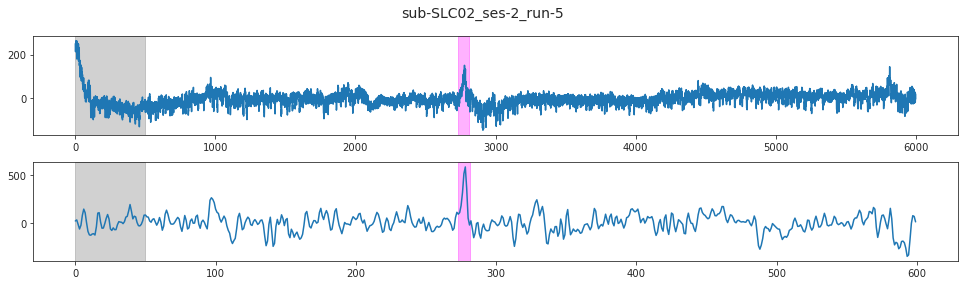

In [5]:
a, b = 273, 281

fig, axes = create_figure(2, 1, (13.5, 4))
axes[0].plot(out2d['gs'])
axes[1].plot(out3d['gs'])
axes[0].axvspan(a * 10, b * 10, color='magenta', alpha=0.3)
axes[1].axvspan(a, b, color='magenta', alpha=0.3)
axes[0].axvspan(0, 50 * 10, color='dimgrey', alpha=0.3)
axes[1].axvspan(0, 50, color='dimgrey', alpha=0.3)
fig.suptitle(key, fontsize=14)
plt.show()

In [6]:
def plot_1(gs2d, gs3d, key, nb_stds=2, ab=None, chunk_size=300, alpha=0.2):

    num = int(600 / chunk_size)
    nrows = 2 * (num + 1)

    fig, axes = create_figure(nrows, 1, (13.5, 2 * nrows),
                              gridspec_kw={'height_ratios': [1.5] * 2 + [1] * num * 2})
    axes[0].plot(gs2d, color='g')
    axes[1].plot(gs3d, color='r')
    
    sd = bn.nanstd(gs2d)
    axes[0].axhspan(- nb_stds * sd, nb_stds * sd, color='gold', lw=3, alpha=alpha)
    axes[0].axhline(- (nb_stds + 1) * sd, color='gold', ls='--')
    axes[0].axhline((nb_stds + 1) * sd, color='gold', ls='--')
    sd = bn.nanstd(gs3d)
    axes[1].axhspan(- nb_stds * sd, nb_stds * sd, color='gold', lw=3, alpha=alpha)
    axes[1].axhline(- (nb_stds + 1) * sd, color='gold', ls='--')
    axes[1].axhline((nb_stds + 1) * sd, color='gold', ls='--')
    
    if ab is not None:
        a, b = ab
        axes[0].axvspan(a * 10, b * 10, color='magenta', alpha=0.3)
        axes[1].axvspan(a, b, color='magenta', alpha=0.3)

    for i in range(1, num + 1):
        start = (i - 1) * chunk_size
        end = i * chunk_size
        intvl = range(start * 10, min(end * 10, len(gs2d)))
        axes[2 * i].plot(intvl, gs2d[intvl], color='dimgrey')

        intvl = range(start, min(end, len(gs3d)))
        axes[2 * i + 1].plot(intvl, gs3d[intvl], color='k')
        
        sd = bn.nanstd(gs2d[intvl])
        axes[2 * i].axhspan(- nb_stds * sd, nb_stds * sd, color='gold', alpha=alpha)
        sd = bn.nanstd(gs3d[intvl])
        axes[2 * i + 1].axhspan(- nb_stds * sd, nb_stds * sd, color='gold', alpha=alpha)
        

    for i in range(2):
        axes[2 * i].axvspan(0, 50 * 10, color='dimgrey', alpha=0.3)
        axes[2 * i + 1].axvspan(0, 50, color='dimgrey', alpha=0.3)

    fig.suptitle(f"plot #1, {key}", fontsize=14, y=1.02)
    plt.show()
    
    return fig, axes


def plot_2(out2d, key, threshold=0.05):
    xlist = [out2d['mu_abs'], out2d['mu'], out2d['sd'], out2d['snr'], out2d['m']]
    mu_abs, mu, sd, snr, m = filter_boundaries(xlist, out2d['m'])
    snr = np.abs(snr)
    
    fig1, axes = create_figure(1, 4, (13, 3.2), gridspec_kw={'width_ratios': [1, 1, 1, 1.5]})

    im = axes[0].imshow(mu_abs, cmap='Spectral')
    plt.colorbar(im, ax = axes[0], shrink=0.7)

    im = axes[1].imshow(mu, cmap='Spectral')
    plt.colorbar(im, ax = axes[1], shrink=0.7)

    im = axes[2].imshow(sd, cmap='Spectral')
    plt.colorbar(im, ax = axes[2], shrink=0.7)

    im = axes[3].imshow(snr, cmap='Spectral')
    plt.colorbar(im, ax = axes[3])

    axes[0].set_title(r'$\mu$ (abs)')
    axes[1].set_title(r'$\mu$')
    axes[2].set_title(r'$\sigma$')
    axes[3].set_title(r'tSNR $ = abs(\mu / \sigma)$')
    fig1.suptitle(f"plot #2, {key}", fontsize=14, y=1.02)
    remove_ticks(axes)
    plt.show()
    
    fig2, axes = create_figure(1, 2, (12, 2.7))

    vals = snr[np.logical_and(m, np.isfinite(snr))]
    vals = np.abs(vals)
    q = np.quantile(vals, threshold)
    sns.histplot(vals, ax=axes[0])
    axes[0].axvline(q, color='r', ls='--')
    axes[1].imshow(snr > q)
    remove_ticks(axes[1])
    plt.show()
    
    gs_good = out2d['x'][np.logical_and(out2d['m'], np.abs(out2d['snr']) > q)].mean(0)
    gs_bad = out2d['x'][np.logical_and(out2d['m'], np.abs(out2d['snr']) <= q)].mean(0)
    
    fig3, ax = create_figure(1, 1, (13, 4), sharex='all', sharey='all')
    ax.plot(gs_bad, color='r', lw=0.7, label='gs bad')
    ax.plot(gs_good, color='k', lw=0.9, label='gs good')
    ax.legend(fontsize='large')
    ax.grid()
    plt.show()
    
    return fig1, fig2, fig3


def plot_3(out3d, key, threshold=0.05, slice_ids=None):
    slice_ids = slice_ids if slice_ids else [10, 20, 30, 40]
    snr = np.abs(out3d['snr'])
    
    fig1, axes = create_figure(
        3, len(slice_ids) + 1, figsize=(13, 6.),
        gridspec_kw={'width_ratios': [1] * len(slice_ids) + [1.6]})

    for i in range(3):
        for j, s in enumerate(slice_ids):
            x2plt = np.take(snr, s, axis=i)
            if i == 2:
                x2plt = x2plt.T
            im = axes[i, j].imshow(x2plt, cmap='Spectral')
            plt.colorbar(im, ax=axes[i, j], shrink=0.7)
        x2plt = bn.nanmean(snr, axis=i)
        x2plt = filter_boundaries(x2plt, out3d['m'].mean(i).astype(bool))
        if i == 2:
            x2plt = x2plt.T
        im = axes[i, -1].imshow(x2plt, cmap='Spectral')
        plt.colorbar(im, ax=axes[i, -1], shrink=0.7)
        fig1.suptitle(f"plot #3, {key}", fontsize=14, y=1.01)

    remove_ticks(axes)
    plt.show()

    fig2, axes = create_figure(1, 4, (13, 2.7))

    vals = out3d['snr'][np.logical_and(out3d['m'], np.isfinite(out3d['snr']))]
    vals = np.abs(vals)
    q = np.quantile(vals, threshold)
    above = out3d['snr'] > q
    sns.histplot(vals, ax=axes[0])
    axes[0].axvline(q, color='r', ls='--')
    for i in range(1, 4):
        axes[i].imshow(above.mean(i - 1))
        remove_ticks(axes[i])
    plt.show()
    
    return fig1, fig2


def plot_4(mice, sub, ses, brief: bool = True, display: bool = True, threshold=0.05):
    data = []
    for run in mice.cfg.run_ids:
        key = mice.get_key(sub, ses, run)
        out2d, _ = _load(mice, key, 'ca2')

        snr, m = filter_boundaries([out2d['snr'], out2d['m']], out2d['m'])
        vals = snr[np.logical_and(m, np.isfinite(snr))]
        vals, snr = np.abs(vals), np.abs(snr)
        q = np.quantile(vals, threshold)

        data.append((snr, m, vals, q))

    if brief:
        nrows = 2
        fig, axes = create_figure(
            nrows=nrows,
            ncols=len(data),
            figsize=(13, 2 * nrows),
        )
        for i in range(len(data)):
            snr, _, _, q = data[i]
            axes[0, i].imshow(snr, cmap='Spectral')
            axes[1, i].imshow(snr > q)
            axes[0, i].set_title(f"run # {i+1}", y=1.03)
        remove_ticks(axes)
        sup = f"{key} / temporal SNR = "
        sup += r'$\mu / \sigma$'
        sup = fig.suptitle(sup, fontsize=14, y=1.03)
    
    else:
        ncols = 6
        nrows = int(np.ceil(len(data) / 2))
        fig, axes = create_figure(
            nrows=nrows,
            ncols=ncols,
            figsize=(13, 2. * nrows),
            gridspec_kw={'width_ratios': [1.4, 1, 1.2] * 2},
        )
        for i in range(nrows):
            for j in range(2):
                idx = 2 * i + j
                try:
                    snr, m, vals, q = data[idx]
                except IndexError:
                    continue

                im = axes[i, 3 * j].imshow(snr, cmap='Spectral')
                plt.colorbar(im, ax=axes[i, 3 * j], shrink=0.8)
                axes[i, 3 * j + 1].imshow(snr > q)
                sns.histplot(vals, ax=axes[i, 3 * j + 2])
                axes[i, 3 * j + 2].axvline(q, color='r', ls='--', lw=1, label=f"q = {q:0.3f}")
                axes[i, 3 * j + 2].legend()
                axes[i, 3 * j + 2].grid()
                remove_ticks(axes[i, :2])
                remove_ticks(axes[i, 3:5])
        remove_ticks(axes.flat[-1])
        sup = f"{key} / temporal SNR = "
        sup += r'$\mu / \sigma$'
        sup = fig.suptitle(sup, fontsize=17, y=1.03)
        
    if display:
        plt.show()
    else:
        plt.close()
        
    return fig, sup, axes

In [7]:
key = 'sub-SLC02_ses-3_run-3'
out2d, out3d = _load(mice, key)

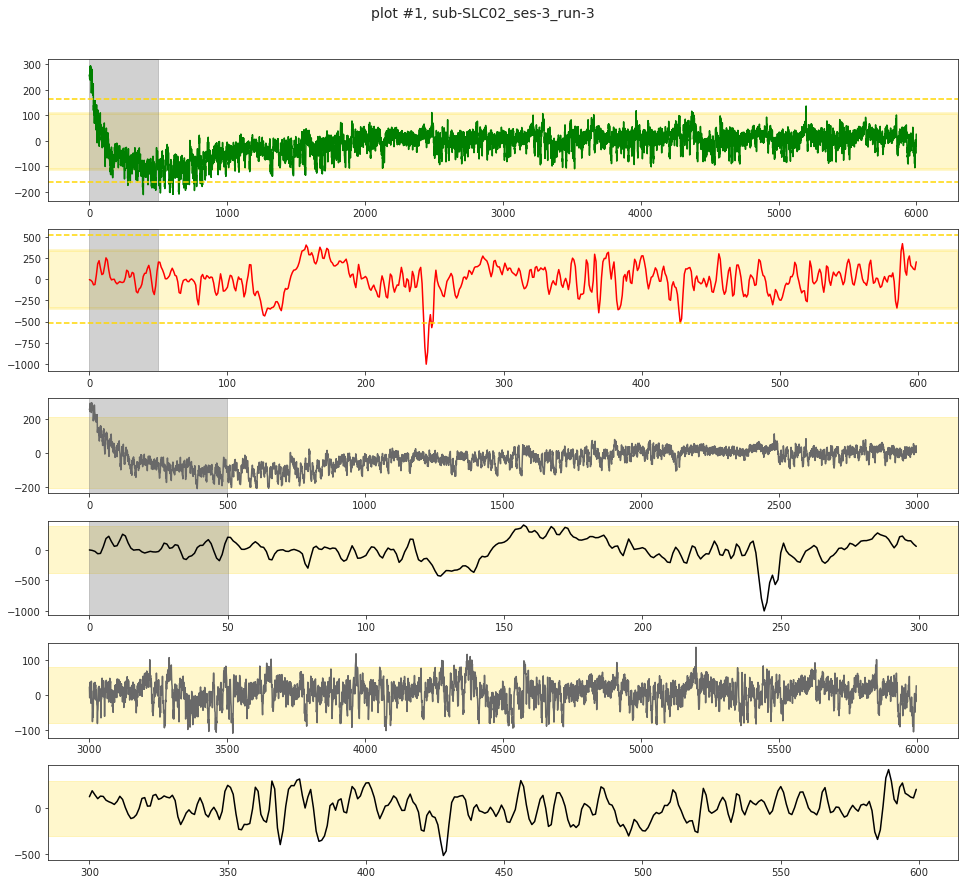

In [8]:
_ = plot_1(out2d['gs'], out3d['gs'], key, chunk_size=300)

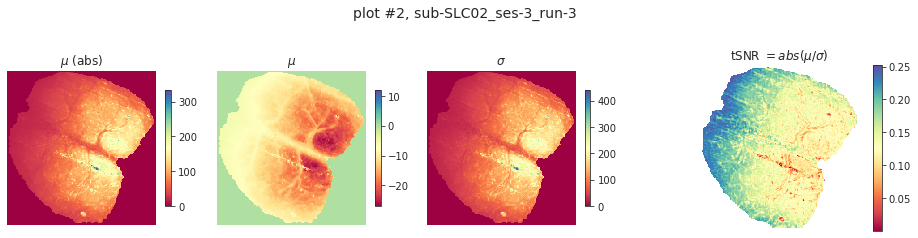

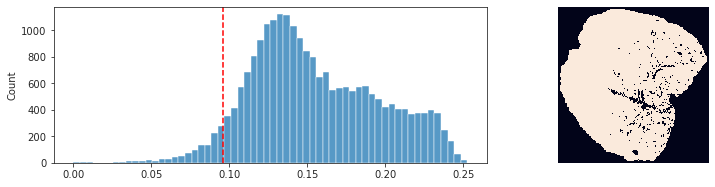

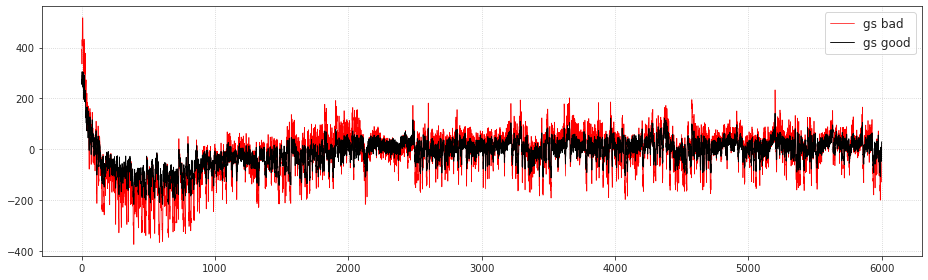

In [9]:
_ = plot_2(out2d, key)

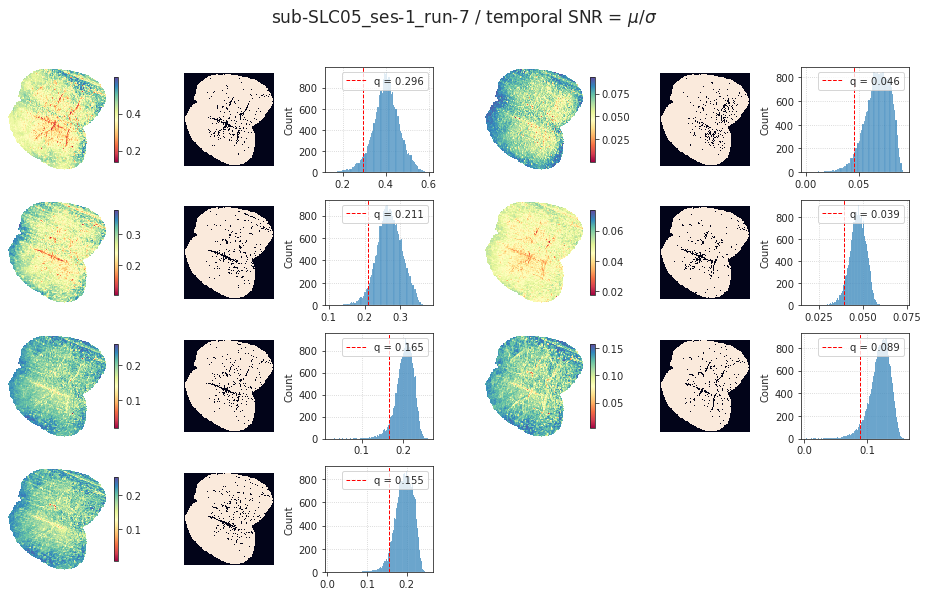

In [10]:
_ = plot_4(mice, 5, 1, brief=False, display=True)

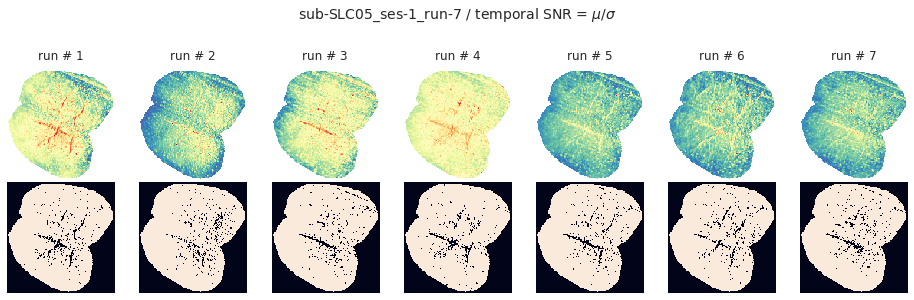

CPU times: user 1min 3s, sys: 3min 27s, total: 4min 30s
Wall time: 5min 56s


In [11]:
%%time
fig, sup, axes = plot_4(mice, 5, 1, brief=True, display=True)

[<matplotlib.lines.Line2D object at 0x7ef1e3e5b8b0>]

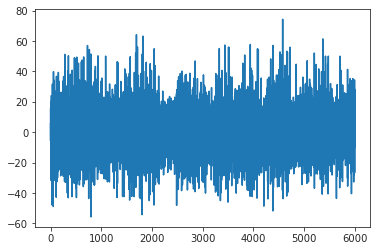

In [12]:
dx = np.gradient(out2d['gs'])

plt.plot(dx)

In [13]:
len(dx), len(out2d['gs'])

(6000, 6000)

In [14]:
good = np.where(np.abs(dx) < 50)[0]
len(good)

5961

[<matplotlib.lines.Line2D object at 0x7ef1e405fa00>]

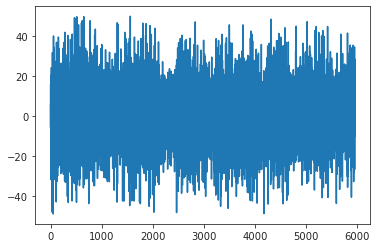

In [15]:
plt.plot(dx[good])

[<matplotlib.lines.Line2D object at 0x7ef1e407baf0>]

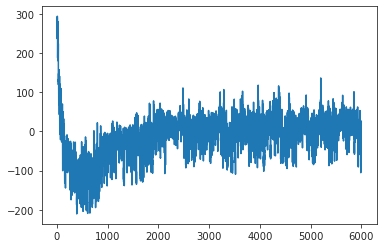

In [16]:
plt.plot(out2d['gs'])

[<matplotlib.lines.Line2D object at 0x7ef1e40c1370>]

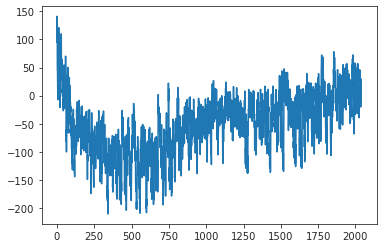

In [17]:
plt.plot(out2d['gs'][50:2090])

[<matplotlib.lines.Line2D object at 0x7ef1e3ff4220>]

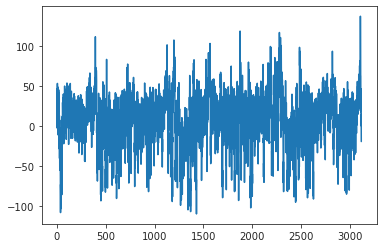

In [18]:
plt.plot(out2d['gs'][2090:5210])

[<matplotlib.lines.Line2D object at 0x7ef1e3cdc310>]

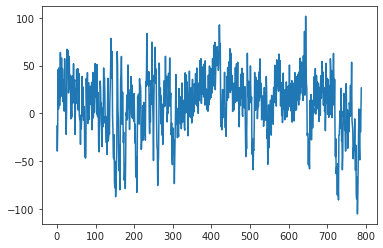

In [19]:
plt.plot(out2d['gs'][5211:])

  0%|          | 0/246 [00:00<?, ?it/s]

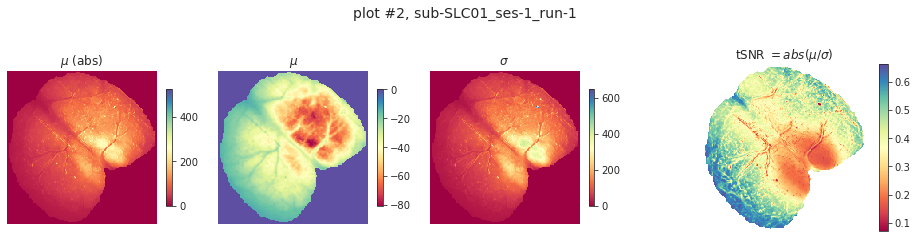

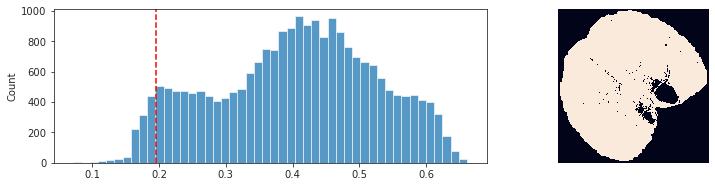

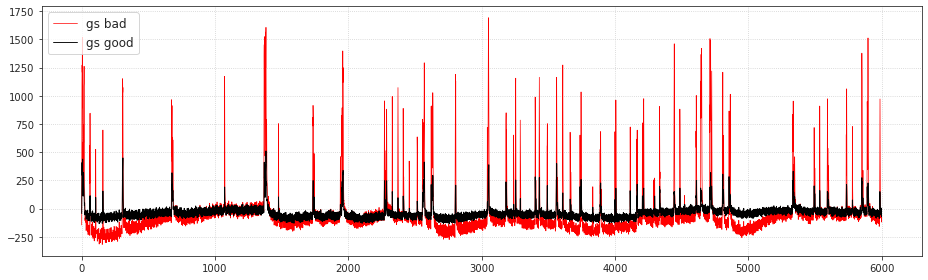

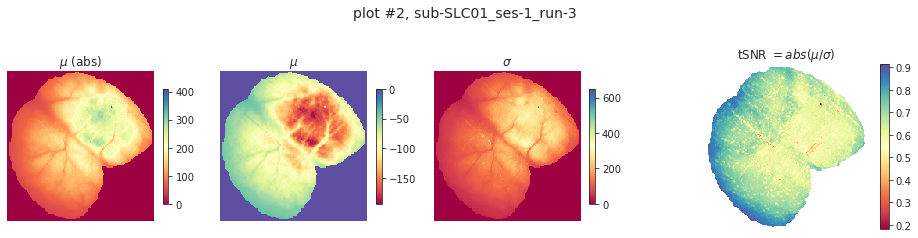

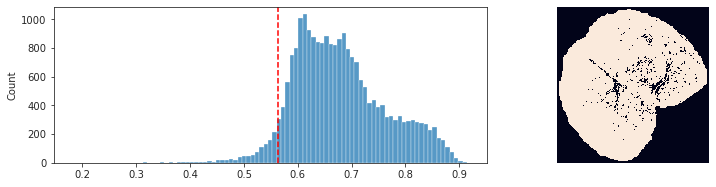

...

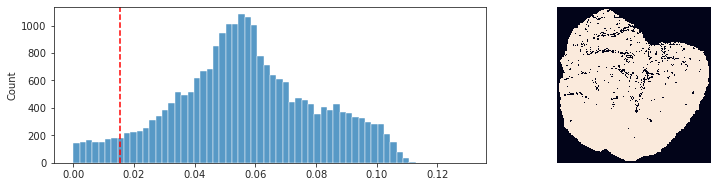

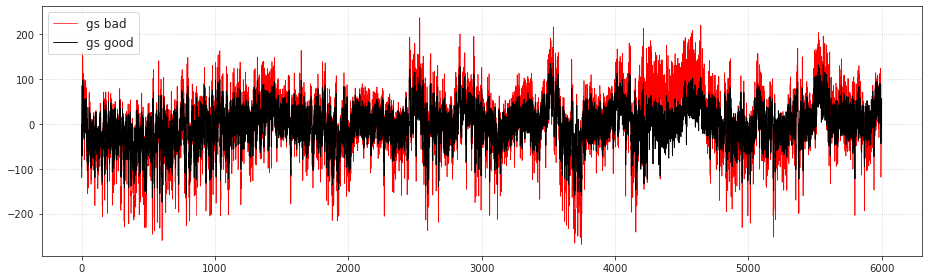

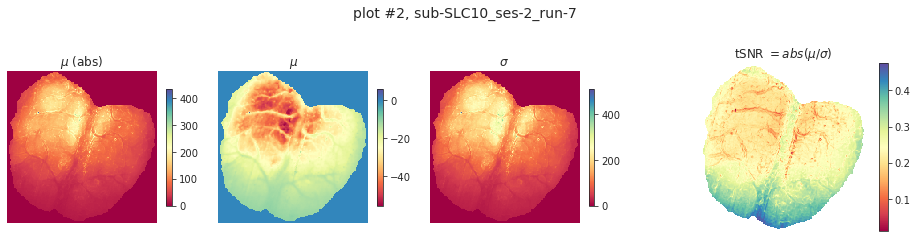

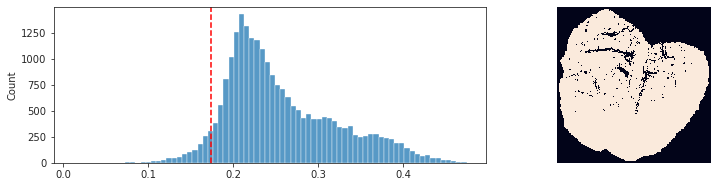

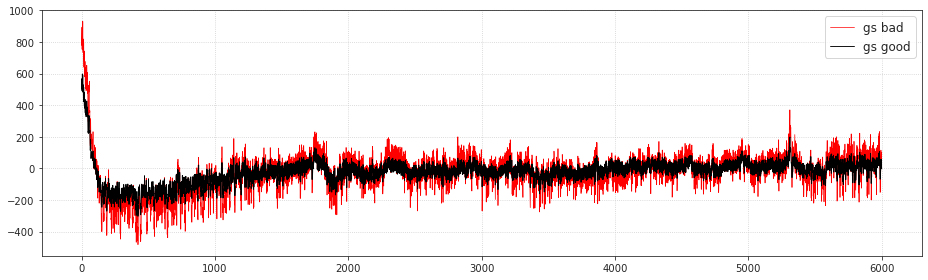

In [25]:
for key, (sub, ses, run) in tqdm(mice.looper.items()):
    func = mice.ca.get(key)
    if run == -1 or func is None or func.task != 'rest':
        continue

    try:
        out2d, _ = _load(mice, key, 'ca2')
    except TypeError:
        continue

    _ = plot_2(out2d, key)

In [12]:
key = 'sub-SLC04_ses-2_run-1'
out2d, out3d = _load(mice, key)

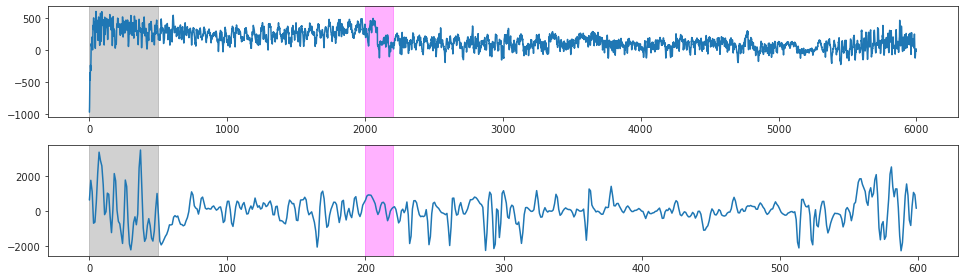

In [16]:
a, b = 200, 220

fig, axes = create_figure(2, 1, (13.5, 4))
axes[0].plot(out2d['gs'])
axes[1].plot(out3d['gs'])
axes[0].axvspan(a * 10, b * 10, color='magenta', alpha=0.3)
axes[1].axvspan(a, b, color='magenta', alpha=0.3)
axes[0].axvspan(0, 50 * 10, color='dimgrey', alpha=0.3)
axes[1].axvspan(0, 50, color='dimgrey', alpha=0.3)

plt.show()

In [17]:
out3d['x'].shape

(64, 64, 78, 600)

<matplotlib.image.AxesImage object at 0x7eebbae34ee0>

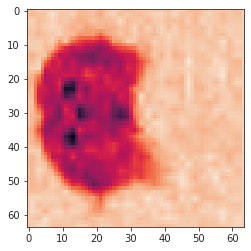

In [35]:
plt.imshow(out3d['x'][..., 40, 32])

<matplotlib.image.AxesImage object at 0x7eebbaca4c40>

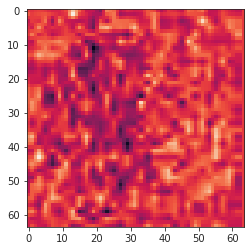

In [41]:
plt.imshow(out3d['x'][..., 40, 210])

In [1]:
dlist = []
for key, (sub, ses, run) in tqdm(mice.looper.items()):
    if run == -1:
        continue
    
    try:
        out2d, out3d = _load(mice, key)
    except TypeError:
        continue

    fig, axes = create_figure(2, 1, (13.5, 4))
    axes[0].plot(out2d['gs'])
    axes[1].plot(out3d['gs'])
    #axes[0].axvspan(a * 10, b * 10, color='magenta', alpha=0.3)
    #axes[1].axvspan(a, b, color='magenta', alpha=0.3)
    axes[0].axvspan(0, 50 * 10, color='dimgrey', alpha=0.3)
    axes[1].axvspan(0, 50, color='dimgrey', alpha=0.3)
    fig.suptitle(key, fontsize=14)
    plt.show()
    
    fig, axes = create_figure(2, 1, (13.5, 4))
    axes[0].plot(out2d['gs'][500:])
    axes[1].plot(out3d['gs'][50:])
    fig.suptitle(f"{key} (first 50s excluded)", fontsize=14)
    plt.show()
    
    print('\n')

NameError: name 'tqdm' is not defined

In [102]:
dlist = []
for key, (sub, ses, run) in tqdm(mice.looper.items()):
    if run == -1:
        continue
    
    if key != 'sub-SLC02_ses-2_run-5':
        continue

    m3d = mice.mask3d[mice.get_key(sub, ses)]
    m3d = m3d.load_ants().numpy().astype(bool)
    x3d = mice.bold_preproc[key][:]
    if x3d is not None:
        mu3d = x3d[m3d].mean(-1)
        sd3d = x3d[m3d].std(-1)
        snr3d = mu3d / sd3d
        snr3d = bn.nanmean(np.abs(snr3d))
    else:
        snr3d = np.nan
    
    m2d = mice.mask2d[mice.get_key(sub, ses)]
    m2d = m2d.load_ants().numpy().astype(bool)
    x2d = mice.ca_preproc[key][:]   

    if x2d is not None:
        mu2d = x2d[m2d].mean(-1)
        sd2d = x2d[m2d].std(-1)
        snr2d = mu2d / sd2d
        snr2d = bn.nanmean(np.abs(snr2d)) 
    else:
        snr2d = np.nan
    
    dlist.append({
        'key': [key] * 2,
        'mode': ['bold', 'ca'],
        'snr': [snr3d, snr2d],
        'mu': [bn.nanmean(mu3d), bn.nanmean(mu2d)],
        'sd': [bn.nanmean(sd3d), bn.nanmean(sd2d)],
    })
    
df = pd.DataFrame(merge_dicts(dlist))

  0%|          | 0/246 [00:00<?, ?it/s]

In [103]:
df

,key,mode,snr,mu,sd
0,sub-SLC02_ses-2_run-5,bold,8.983133e-09,1.277172e-07,108.828526
1,sub-SLC02_ses-2_run-5,ca,1.264494e-01,-7.993031e+00,69.845843


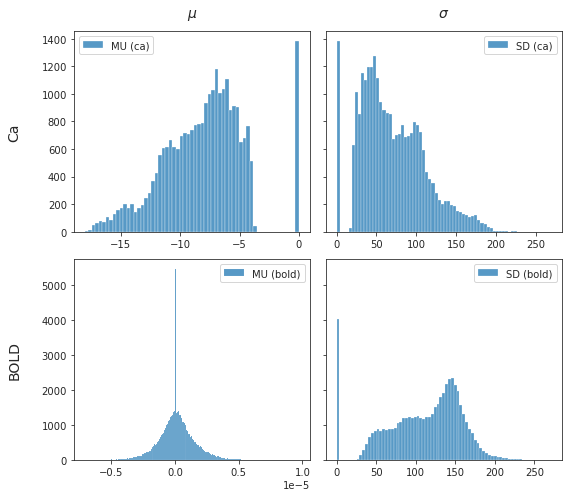

In [135]:
fig, axes = create_figure(2, 2, (8, 7), sharey='row')
sns.histplot(mu2d, ax=axes[0, 0], stat='count', label='MU (ca)')
sns.histplot(sd2d, ax=axes[0, 1], stat='count', label='SD (ca)')
sns.histplot(mu3d, ax=axes[1, 0], stat='count', label='MU (bold)')
sns.histplot(sd3d, ax=axes[1, 1], stat='count', label='SD (bold)')

axes[0, 0].set_ylabel('Ca\n', fontsize=14)
axes[1, 0].set_ylabel('BOLD\n', fontsize=14)

axes[0, 0].set_title(r'$\mu$', fontsize=14, y=1.04)
axes[0, 1].set_title(r'$\sigma$', fontsize=14, y=1.04)

for ax in axes.flat:
    ax.legend()

plt.show()

In [119]:
gs2d = x2d[m2d].mean(0)
gs3d = x3d[m3d].mean(0)

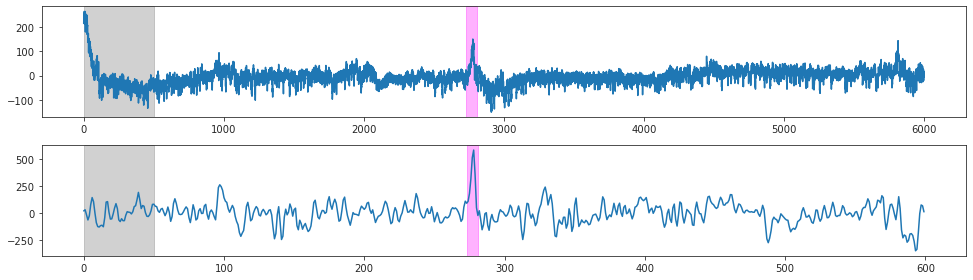

In [136]:
a, b = 273, 281

fig, axes = create_figure(2, 1, (13.5, 4))
axes[0].plot(gs2d)
axes[1].plot(gs3d)
axes[0].axvspan(a * 10, b * 10, color='magenta', alpha=0.3)
axes[1].axvspan(a, b, color='magenta', alpha=0.3)
axes[0].axvspan(0, 50 * 10, color='dimgrey', alpha=0.3)
axes[1].axvspan(0, 50, color='dimgrey', alpha=0.3)

plt.show()

<AxesSubplot:xlabel='snr', ylabel='Count'>

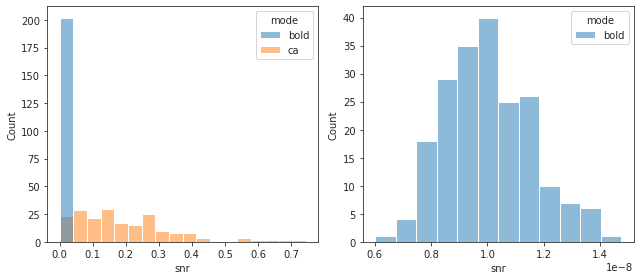

In [34]:
fig, axes = create_figure(1, 2, (9, 4))

sns.histplot(data=df, x='snr', hue='mode', ax=axes[0])
sns.histplot(data=df.loc[df['mode'] == 'bold'], x='snr', hue='mode', ax=axes[1])

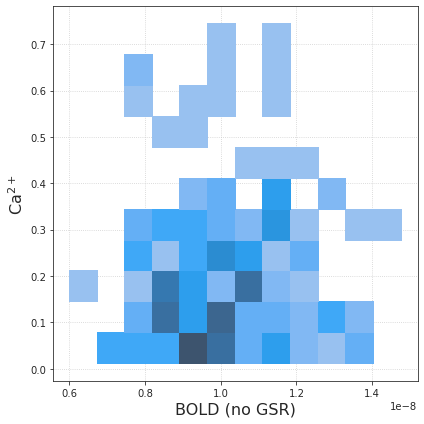

In [35]:
fig, ax = create_figure(1, 1, (6, 6))

sns.histplot(
    x=df.loc[df['mode'] == 'bold', 'snr'].values,
    y=df.loc[df['mode'] == 'ca', 'snr'].values,
    ax=ax,
)
ax.set_xlabel('BOLD (no GSR)', fontsize=16)
ax.set_ylabel(r'Ca$^{2+}$', fontsize=16)
ax.grid()
plt.show()

In [43]:
_df = df.loc[df['mode'] == 'bold']
sorted_ids = _df['snr'].argsort().values
_df = _df.iloc[sorted_ids]

In [45]:
_df[:20]

,key,mode,snr
80,sub-SLC02_ses-3_run-6,bold,6.007847e-09
390,sub-SLC10_ses-1_run-7,bold,8.886713e-09
146,sub-SLC04_ses-2_run-4,bold,7.032892e-09
202,sub-SLC05_ses-3_run-4,bold,9.647223e-09
82,sub-SLC02_ses-3_run-7,bold,7.281850e-09
22,sub-SLC01_ses-2_run-5,bold,7.469309e-09
150,sub-SLC04_ses-2_run-6,bold,7.505907e-09
290,sub-SLC07_ses-3_run-6,bold,1.068917e-08
152,sub-SLC04_ses-2_run-7,bold,7.621441e-09
54,sub-SLC02_ses-1_run-7,bold,7.654515e-09


In [49]:
key = _df.iloc[0]['key']
key

'sub-SLC02_ses-3_run-6'

In [72]:
key = 'sub-SLC02_ses-2_run-5'
mask = mice.mask3d[mice.get_key(*mice.looper[key][:2])]
mask = mask.load_ants().numpy().astype(bool)
x = mice.bold_preproc[key][:]
x.shape, mask.shape

((64, 64, 78, 600), (64, 64, 78))

<matplotlib.image.AxesImage object at 0x7e241f520070>

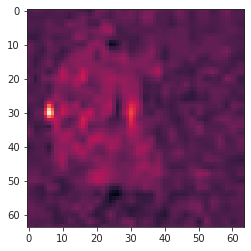

In [73]:
plt.imshow(x[..., 40, 180])

<matplotlib.image.AxesImage object at 0x7e241e86e7c0>

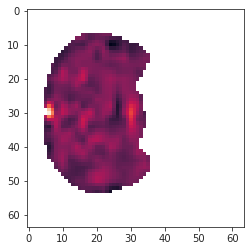

In [85]:
x2plt = np.ma.masked_where(~mask[..., 40], x[..., 40, 180])
plt.imshow(x2plt)

In [86]:
x[30, 6, 40, 180]

687.365478515625

In [91]:
vox = (30, 6, 40)
mu = x[vox].mean()
sd = x[vox].std()

snr = mu / sd
snr

2.318411160768818e-08

In [92]:
mu, sd

(4.036426544189453e-06, 174.10313634148125)

In [95]:
name = 'sub-SLC02_ses-2_run-5_task-rest_space-individual_desc-nogsr_bold'
file = next(f for f in os.listdir(mice.cfg.raw_dir) if name in f)
file = pjoin(mice.cfg.raw_dir, file)
img = ants.image_read(file)

In [96]:
img

ANTsImage
         Pixel Type : float (float32)
         Components : 1
         Dimensions : (64, 64, 78, 600)
         Spacing    : (0.2, 0.2, 0.2, 1.0)
         Origin     : (6.4, -6.2, -7.8, 0.0)
         Direction  : [1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 1.]

<matplotlib.image.AxesImage object at 0x7e241fb94070>

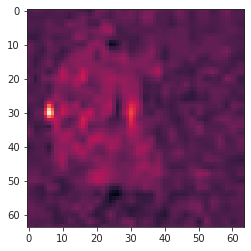

In [97]:
plt.imshow(img[..., 40, 180])

In [88]:
mu = x[mask].mean(-1)
sd = x[mask].std(-1)
snr = mu / sd

<AxesSubplot:ylabel='Count'>

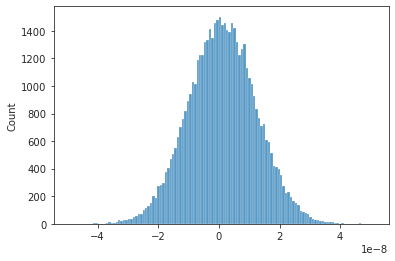

In [89]:
sns.histplot(snr)

<AxesSubplot:ylabel='Count'>

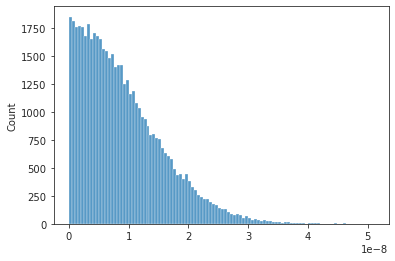

In [90]:
sns.histplot(np.abs(snr))

In [100]:
vox = (30, 6, 40)
mu = img[vox].mean()
sd = img[vox].std()

snr = mu / sd
mu, sd, snr

(7.73112e-06, 174.10313, 4.4405404e-08)

In [101]:
vox = (30, 6, 40)
mu = x[vox].mean()
sd = x[vox].std()

snr = mu / sd
mu, sd, snr

(4.036426544189453e-06, 174.10313634148125, 2.318411160768818e-08)

[<matplotlib.lines.Line2D object at 0x7f86cf559d60>]

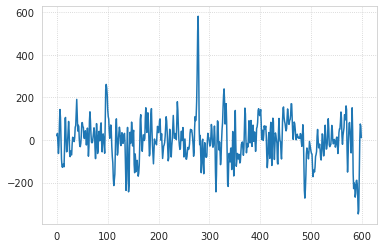

In [65]:
gs = x[mask].mean(0)
plt.plot(gs)

In [67]:
ca = mice.ca_preproc[key][:]
ca.shape

(256, 250, 6000)

In [68]:
m2d = mice.mask2d[mice.get_key(*mice.looper[key][:2])]
m2d = m2d.load_ants().numpy().astype(bool)

<matplotlib.image.AxesImage object at 0x7f86cf4b26d0>

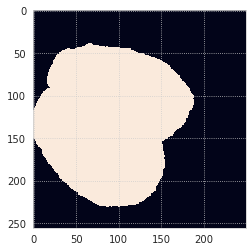

In [69]:
plt.imshow(m2d)

<matplotlib.image.AxesImage object at 0x7f86cf3df0a0>

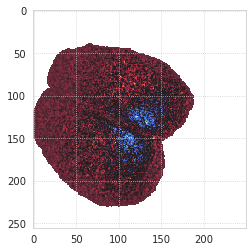

In [72]:
x2plt = np.ma.masked_where(~m2d, ca[..., 1200])
plt.imshow(x2plt, cmap='icefire')

In [80]:
mu = ca[m2d].mean(-1)
sd = ca[m2d].std(-1)
snr2d = mu / sd

<AxesSubplot:ylabel='Density'>

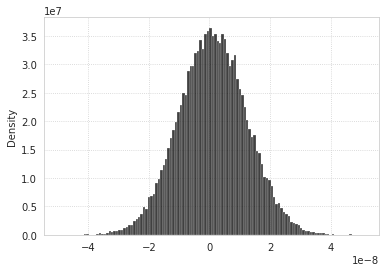

In [81]:
sns.histplot(snr, color='k', stat='density')

<AxesSubplot:ylabel='Density'>

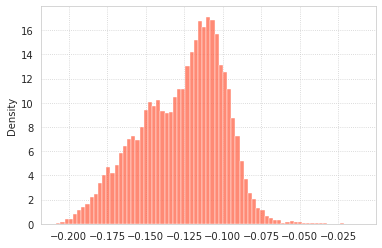

In [82]:
sns.histplot(snr2d, color='tomato', stat='density')

In [86]:
np.nanmean(np.abs(snr)), np.nanmean(np.abs(snr2d))

(8.983133407727028e-09, 0.12644938192572683)